In [211]:
pip install plotly==4.14.3

Note: you may need to restart the kernel to use updated packages.


In [73]:
%pylab inline
%config InlineBackend.figure_formats = ['retina']

import pandas as pd
import prophet
from prophet import Prophet
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

import plotly.express as px
import scipy.stats as stats

Populating the interactive namespace from numpy and matplotlib


/Users/rachelbryn/opt/anaconda3/envs/prophet/lib/python3.9/site-packages/IPython/core/magics/pylab.py:159: UserWarning:

pylab import has clobbered these variables: ['TH', 'SU', 'TU', 'FR', 'SA', 'WE', 'MO']
`%matplotlib` prevents importing * from pylab and numpy



In [74]:
import pandas as pd
import plotly.graph_objects as go
import plotly.express as px
import matplotlib.pyplot as plt
from matplotlib.figure import Figure
from statsmodels.nonparametric.smoothers_lowess import lowess
from pandas.plotting import autocorrelation_plot
from prophet.plot import plot_plotly, plot_components_plotly
from dateutil.relativedelta import *

In [75]:
import seaborn as sns
from prophet.plot import plot_plotly, plot_components_plotly
import plotly.graph_objs as go
import plotly.offline as py


In [202]:
%whos 

Variable                 Type         Data/Info
-----------------------------------------------
All_Data                 DataFrame         Unnamed: 0 Unnamed: <...>\n[381 rows x 22 columns]
Ice_Facebook             DataFrame                  ds\n0     1<...>n[19381 rows x 1 columns]
Ice_Fbprophet            Series       0      13.38\n1      11.9<...>ngth: 381, dtype: float64
LinearRegression         ABCMeta      <class 'sklearn.linear_mo<...>._base.LinearRegression'>
Prophet                  type         <class 'prophet.forecaster.Prophet'>
Sea_Ice_2070             DataFrame                  ds\n0     1<...>n[19381 rows x 1 columns]
Sea_Ice_2070_Forecast    DataFrame                  ds      tre<...>[19381 rows x 16 columns]
X                        DataFrame           CFC11    CFC12  CF<...>n\n[381 rows x 8 columns]
X_test                   DataFrame           CFC11    CFC12  CF<...>\n\n[80 rows x 8 columns]
X_train                  DataFrame           CFC11    CFC12  CF<...>n\n[301 r

In [78]:
All_Data = pd.read_csv('Combined_Carbon_AGAGE_test.csv')
        

In [79]:
All_Data

,Unnamed: 0,Unnamed: 0.1,YYYY,MM,extent,CFC11,CFC12,CFC113,CH3CCl3,CCl4,N20,CH4,Year_x,Month_x,El_Nino,La_Nina,Decimal Date,C02,Year_y,Month_y
0,0,1986-05-01,1986,5,13.38,217.458,406.133,43.903,110.543,99.982,304.778,1659.207,1986,5,1,0,1986.375,347.26,1986,5
1,1,1986-06-01,1986,6,11.98,219.094,410.075,44.562,111.337,100.247,305.527,1652.992,1986,6,1,0,1986.458,347.52,1986,6
2,2,1986-07-01,1986,7,10.15,219.371,410.970,44.670,110.982,100.440,305.535,1650.822,1986,7,1,0,1986.542,347.33,1986,7
3,3,1986-08-01,1986,8,7.98,220.151,412.585,45.120,109.395,100.238,305.560,1648.518,1986,8,1,0,1986.625,347.41,1986,8
4,4,1986-09-01,1986,9,7.41,222.471,417.228,45.792,110.315,100.562,305.845,1668.842,1986,9,1,0,1986.708,348.35,1986,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
376,376,2017-11-01,2017,11,9.49,228.388,511.997,0.000,0.000,78.811,330.892,1856.133,2017,11,0,0,2017.875,407.09,2017,11
377,377,2017-12-01,2017,12,11.74,228.371,511.931,0.000,0.000,78.792,331.043,1851.996,2017,12,0,0,2017.958,407.47,2017,12
378,378,2018-01-01,2018,1,13.08,228.197,511.755,0.000,0.000,78.702,331.139,1850.948,2018,1,1,0,2018.042,407.67,2018,1
379,379,2018-02-01,2018,2,13.97,228.116,511.535,0.000,0.000,78.640,331.211,1851.618,2018,2,1,0,2018.125,407.54,2018,2


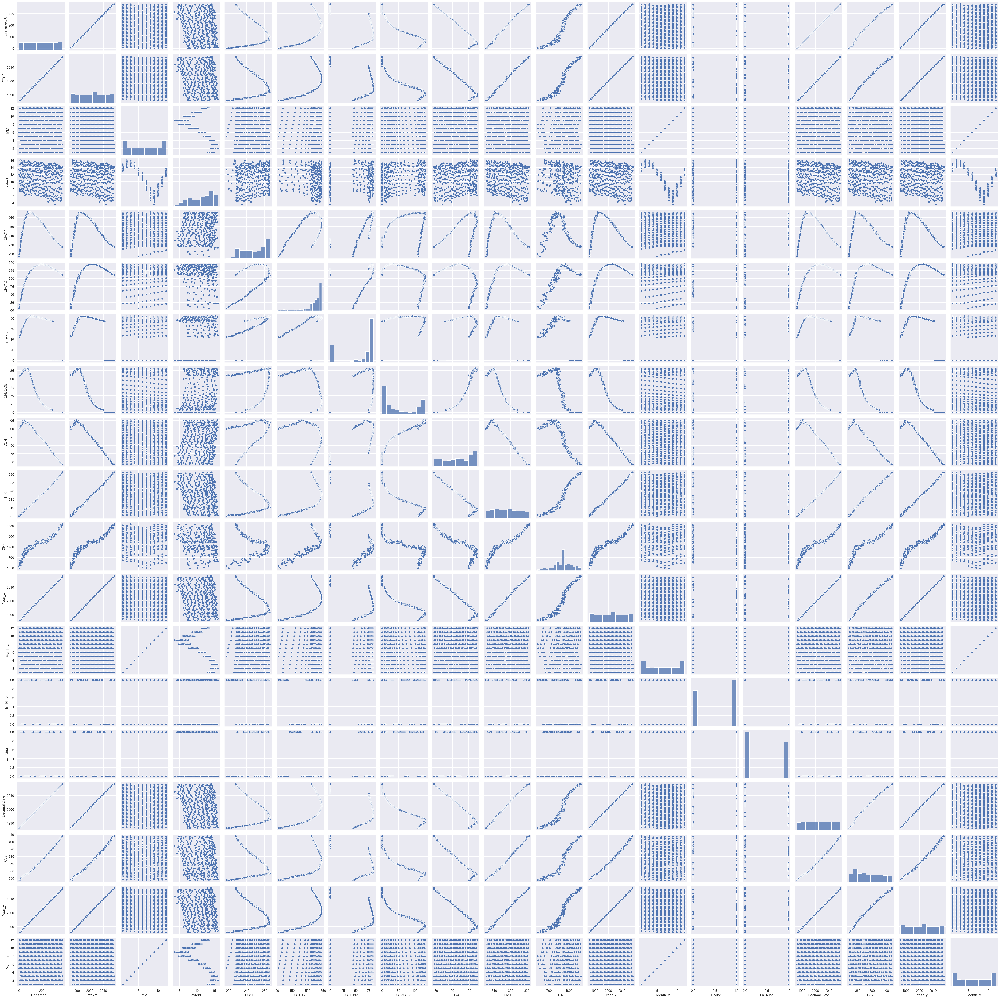

In [67]:
# Using plotly.express
sns.pairplot(All_Data)

In [53]:
September_Data.to_csv('September_Data.csv')

In [80]:
All_Data['Date'] = pd.to_datetime(All_Data['Date'])
All_Data.set_index('Date', inplace=False)



KeyError: 'Date'

In [49]:
fig = go.Figure([go.Scatter(x=All_Data['Date'], y=All_Data['extent'])])
fig.show()

AttributeError: 'DataFrame' object has no attribute 'date'

In [110]:
# Interpolate the mov_avg because some are Null 


In [7]:
## Build a simply linear regression model

X = All_Data.loc[:,['CFC11','CFC12','CFC113','CH4','N20','C02','El_Nino','La_Nina']]

y = All_Data['extent']

In [34]:
# I want to export my All_data dataframe to a new csv that can be played with in a new notebook. 
All_Data.to_csv('ALL_Data_Feature_Engineering_Version.csv')

In [12]:
len(y)

381

In [62]:
# Choose 80% of my data to train (381 rows, 80% is 301 rows)
    
X_train = X.iloc[:301,:]
X_test = X.iloc[301:,:]
y_train = y.iloc[:301]
y_test = y.iloc[301:]
    
    # X_train = X.iloc[:301,:]
    # X_test = X.iloc[301:,:]
    # y_train = y.iloc[:301]
    # y_test = y.iloc[301:]

In [63]:
def split_and_validate(X, y):
    '''
    For a set of features and target X, y, perform a 80/20 train/val split, 
    fit and validate a linear regression model, and report results
    '''
    
    lr_model = LinearRegression()
    lr_model.fit(X_train, y_train)
    
    # score fit model on validation data
    val_score = lr_model.score(X_test, y_test)
    
    # report results
    print('\nValidation R^2 score was:', val_score)
    print('Feature coefficient results: \n')
    for feature, coef in zip(X.columns, lr_model.coef_):
        print(feature, ':', f'{coef:.2f}')

In [64]:
split_and_validate(X, y)


Validation R^2 score was: -0.23500426534302554
Feature coefficient results: 

CFC11 : 0.06
CFC12 : -0.07
CFC113 : 0.04
CH4 : 0.00
N20 : 1.75
C02 : -0.66
El_Nino : 0.24
La_Nina : 0.52


In [ ]:
#laggged term application

<b> My first thought is to smooth the sea ice data. This may improve the simple linear regression model because the model is trying to account for the increase and decrease in the sea ice extent when the features (CH4, C02 and N20 are only going up)</b> 

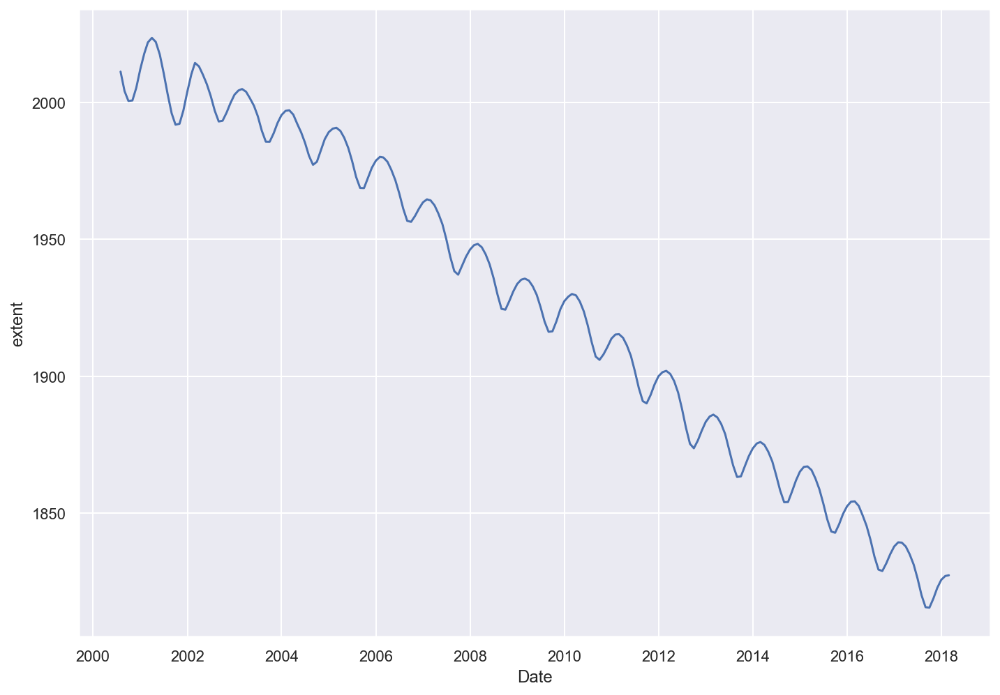

In [30]:
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.lineplot(
    x='Date',
    y='extent',
    data= All_Data)
plt.show()

<b> I calculate the moving average by feature engineering a new column using panda’s built-in rolling method. I chose a window of 170 days (roughly 6 months) because the wavelength of the sinusoidal pattern in the data is one year</b>

In [31]:
# Is this adding an auto-regressive feature to my model? 
All_Data['extent'] = All_Data['extent'].rolling(170).sum()


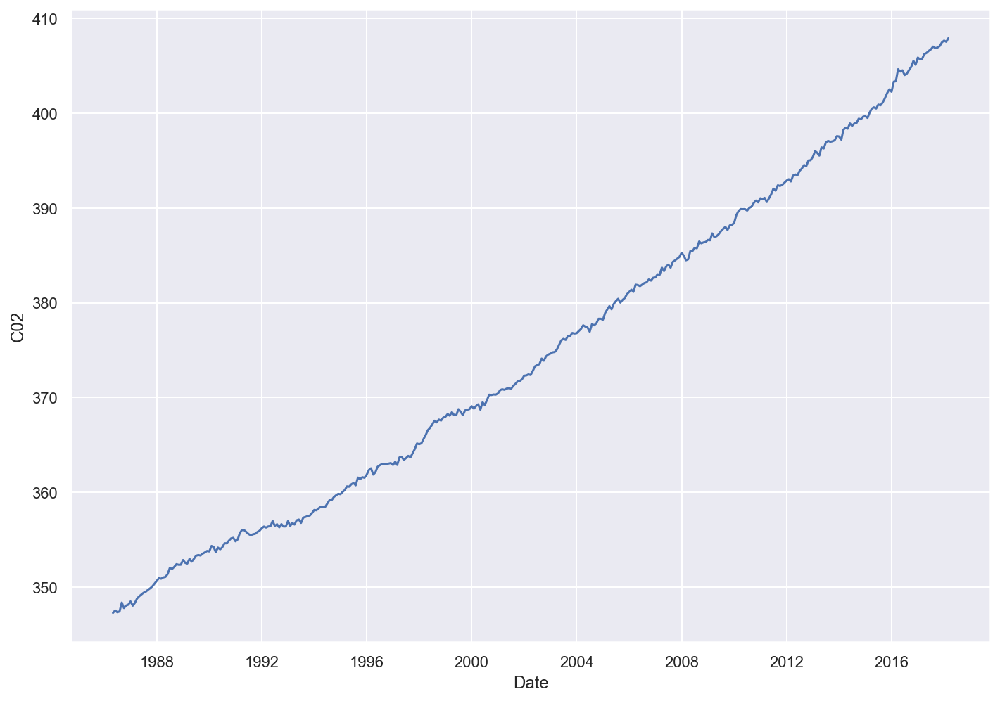

In [42]:
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.lineplot(
    x='Date',
    y='C02',
    data= All_Data)
plt.show()

<b> BELOW WE WILL SEE HOW OUR SEA ICE EXTENT CAN BE FORECASTED USING FACEBOOK PROPHET- THEN WE WILL REVISIT THE REGRESSION MODEL FEATURE ENGINEERING AND FINE TUNING </b>

In [81]:
# Make a new dataframe with only our ice and dates.
Ice_Facebook = All_Data[['Date','extent']]

KeyError: "['Date'] not in index"

In [85]:
# FBprophet only passes in columns named ds and y. 
# Rename my columns 

Ice_Facebook.rename(columns={'Date':'ds'}, inplace=True)
Ice_Facebook.rename(columns={'extent':'y'}, inplace=True)

In [86]:
Ice_Facebook

,ds
0,1986-05-01
1,1986-06-01
2,1986-07-01
3,1986-08-01
4,1986-09-01
...,...
30376,2100-04-16
30377,2100-04-17
30378,2100-04-18
30379,2100-04-19


In [87]:
## Try to use Facebook prophet
# Establish the name of a new prophet model "m"
m = Prophet()
m.fit(Ice_Facebook)

ValueError: Dataframe must have columns "ds" and "y" with the dates and values respectively.

In [88]:
# Let's predict the extent of our sea ice in 2100.
future = m.make_future_dataframe(periods=30000)
future.tail()

Exception: Model has not been fit.

In [13]:
# Create a model that compensates for the yearly oscillations
model = Prophet(yearly_seasonality=True) 

In [14]:
model.fit(Ice_Facebook)

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


<B> FORCASTING </B>

In [15]:
# select the number of periods (in this case, days) to forecast
Ice_Facebook = model.make_future_dataframe(periods=30000)
Ice_Facebook.shape

(30381, 1)

In [16]:
# Check the type 
type(Ice_Facebook)

pandas.core.frame.DataFrame

In [17]:
Ice_Facebook.shape[0] - Ice_Facebook.shape[0]

0

In [18]:
Ice_Facebook.tail()

,ds
30376,2100-04-16
30377,2100-04-17
30378,2100-04-18
30379,2100-04-19
30380,2100-04-20


In [19]:
Sea_Ice_2070_Forecast = model.predict(Ice_Facebook)

In [20]:
Sea_Ice_2070_Forecast.columns

Index(['ds', 'trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper',
       'additive_terms', 'additive_terms_lower', 'additive_terms_upper',
       'yearly', 'yearly_lower', 'yearly_upper', 'multiplicative_terms',
       'multiplicative_terms_lower', 'multiplicative_terms_upper', 'yhat'],
      dtype='object')

In [71]:
fig = plot_plotly(model, Sea_Ice_2070_Forecast, figsize=(800, 600))
fig.update_layout(template='simple_white')

In [23]:
fig = plot_components_plotly(model, Sea_Ice_2070_Forecast, figsize=(800, 200))
fig.update_layout(template='simple_white')